# Advanced Lane Lines Project

## Goal

The goals / steps of this project are the following:

1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
1. Apply a distortion correction to raw images.
1. Use color transforms, gradients, etc., to create a thresholded binary image.
1. Apply a perspective transform to rectify binary image ("birds-eye view").
1. Detect lane pixels and fit to find the lane boundary.
1. Determine the curvature of the lane and vehicle position with respect to center.
1. Warp the detected lane boundaries back onto the original image.
1. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
#%% Library
import re
import cv2
import numpy as np
import matplotlib.pyplot as plt

from pathlib import Path
from collections import defaultdict

from moviepy.editor import VideoFileClip
from IPython.display import HTML

#%% Image Files
calibration_image_dir = Path('./camera_cal')
calibration_image_paths = [image for image in calibration_image_dir.iterdir() if image.match('calibration*.jpg')]

test_image_dir = Path('./test_images')
test_image_paths = [image for image in test_image_dir.iterdir() if image.match('*.jpg')]

#%% Map for Result Image and Parameter
result_map = defaultdict(dict) # result_map[test_image_path][result_image_name]
param_map  = defaultdict(dict) # param_map[test_image_path][param_name]

#%% Output Directory
def get_image_output_dir(name):
    output_dir = Path('./output_images') / name
    output_dir.mkdir(exist_ok=True)
    return output_dir


## Pipeline

### 1. Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

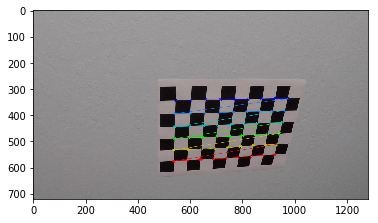

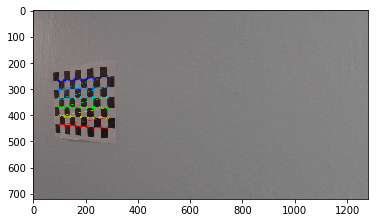

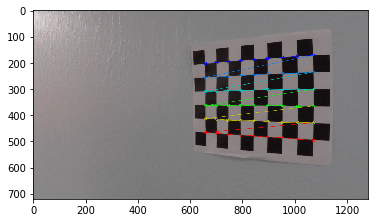

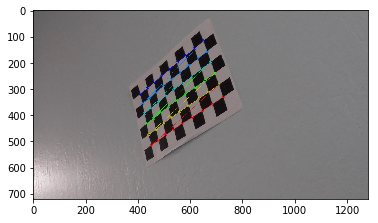

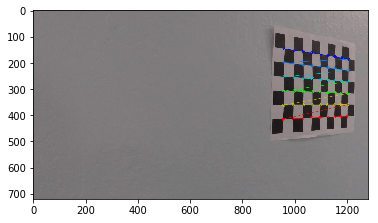

...

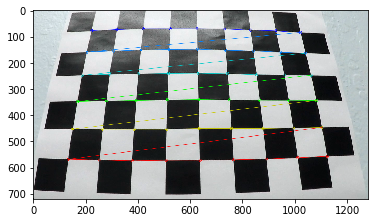

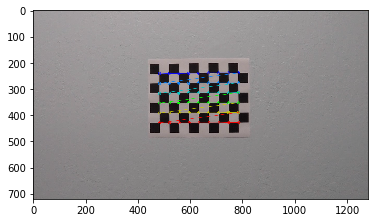

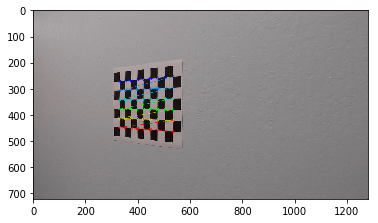

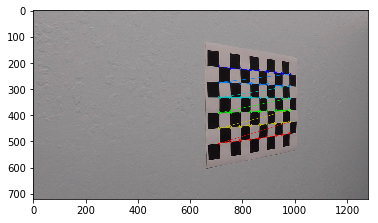

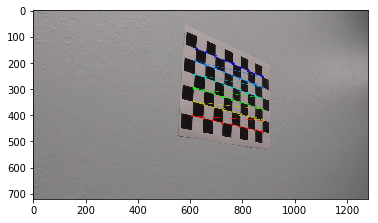

In [2]:
#%% Define function
def compute_camera_calibration_matrix(calibration_image_paths, nx, ny):
    # Prepare object points, like (0,0,0), (1,0,0), (2,0,0), ...,(nx - 1,ny - 1,0)
    objp = np.zeros((nx * ny, 3), np.float32)
    objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    calibration_output_dir = get_image_output_dir('calibration')
    
    for calibration_image_path in calibration_image_paths:
        bgr = cv2.imread(str(calibration_image_path))
        gray = cv2.cvtColor(bgr,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

        # If found, add object points, image points
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)

            img = cv2.drawChessboardCorners(bgr, (nx, ny), corners, ret)
            
            plt.figure()
            plt.imshow(img)
            
            plt.savefig(str(calibration_output_dir / (calibration_image_path.stem + '.jpg')))

    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    
    return mtx, dist
    
#%% Run task
nx, ny = 9, 6
mtx, dist = compute_camera_calibration_matrix(calibration_image_paths, nx, ny)

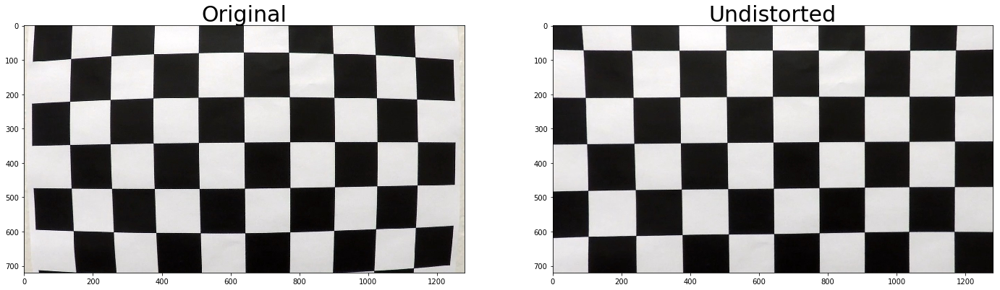

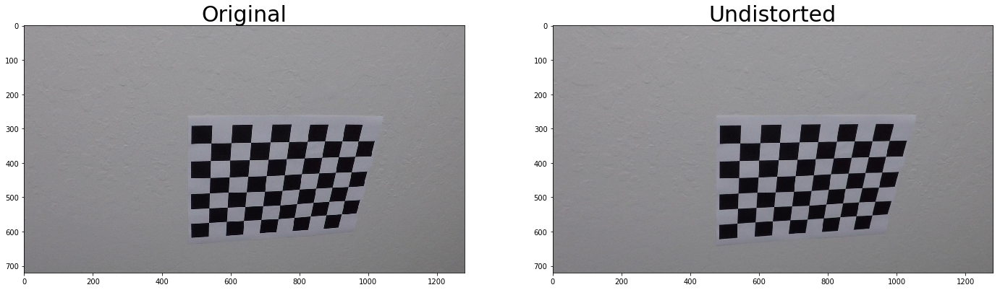

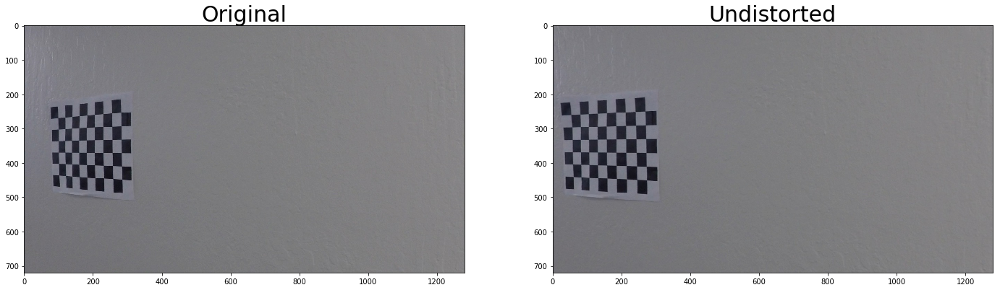

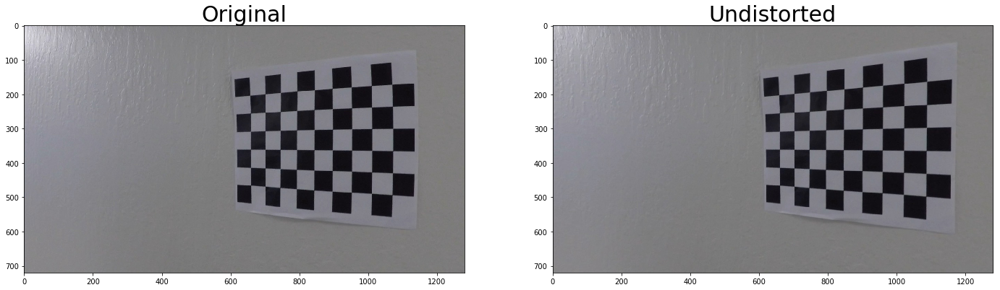

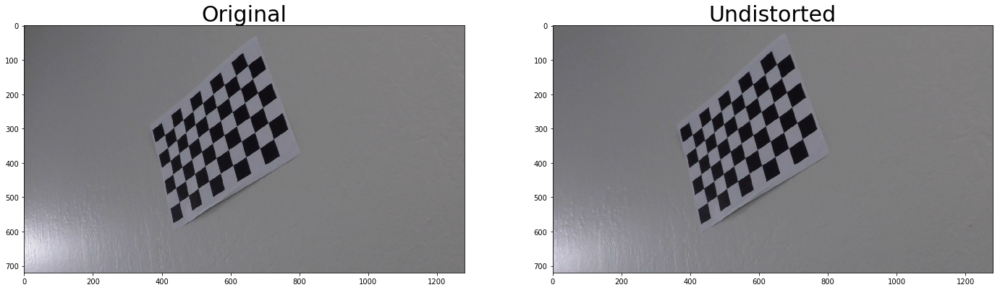

...

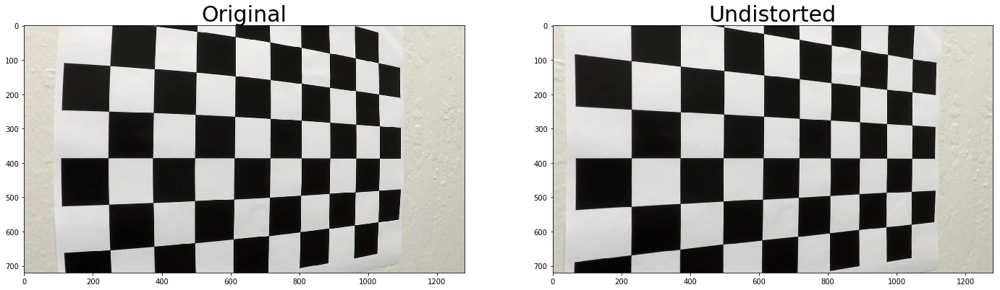

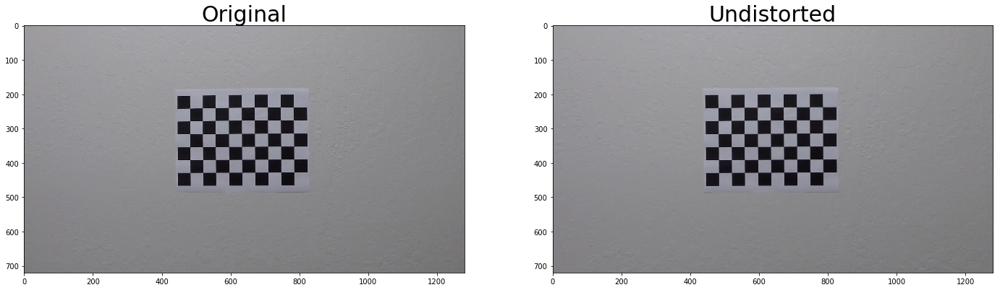

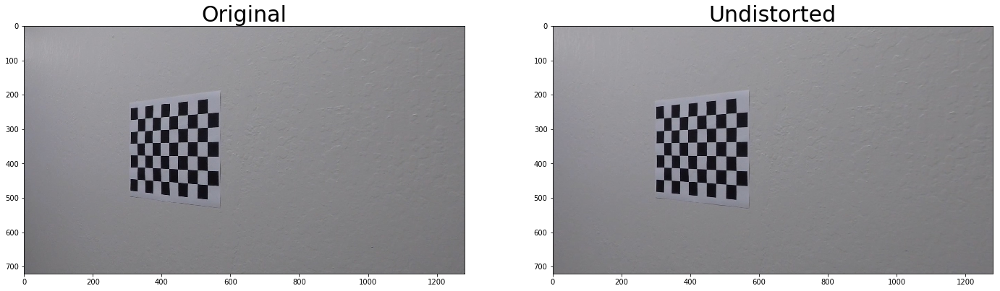

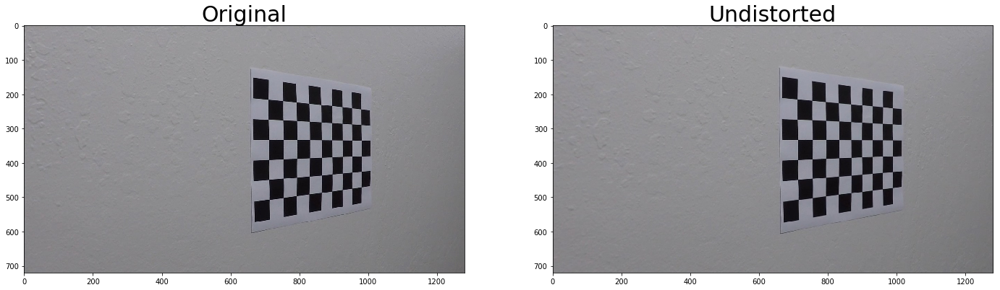

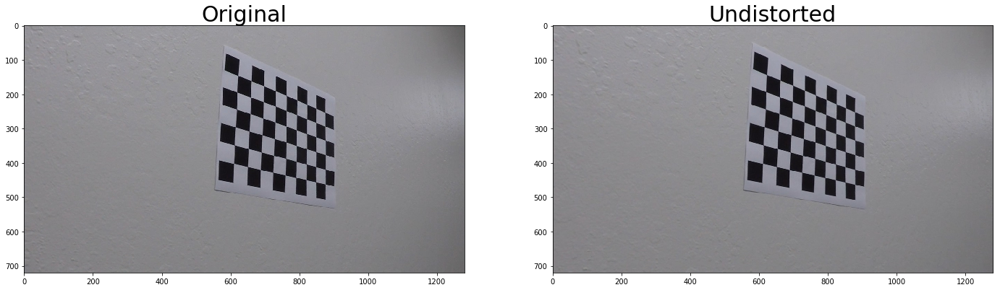

In [3]:
#%% Show result
calibration_undistorted_output_dir = get_image_output_dir('calibration_undistorted')

for calibration_image_path in calibration_image_paths:
    bgr = cv2.imread(str(calibration_image_path))
    rgb = cv2.cvtColor(bgr,cv2.COLOR_BGR2RGB)
    undistorted = cv2.undistort(rgb, mtx, dist, None, mtx)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 7))
    
    ax1.set_title('Original', fontsize=30)
    ax1.imshow(rgb)
    
    ax2.set_title('Undistorted', fontsize=30)
    ax2.imshow(undistorted)

    plt.savefig(str(calibration_undistorted_output_dir / (calibration_image_path.stem + '.jpg')))

### 2. Apply a distortion correction to raw images.

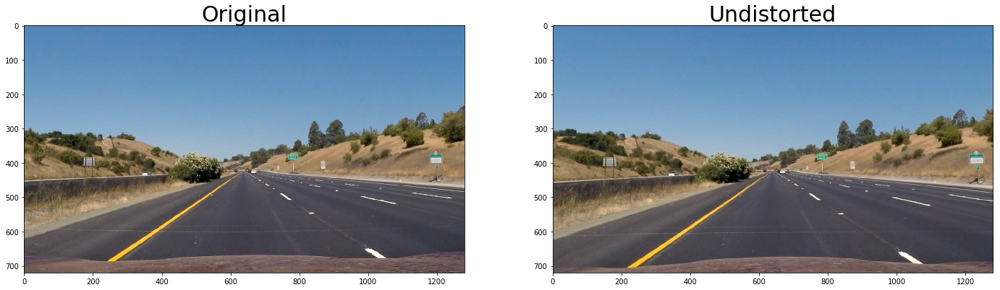

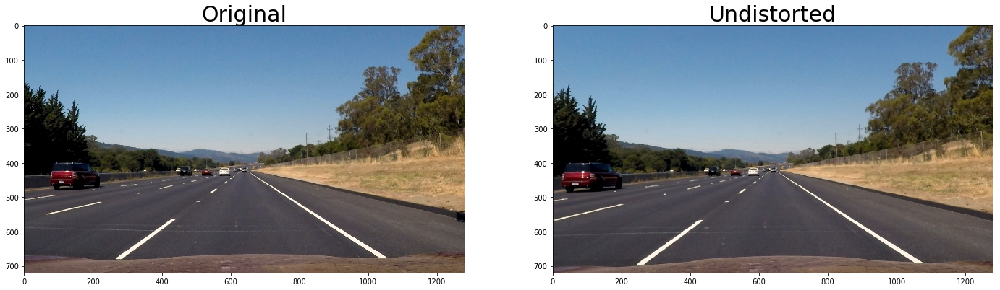

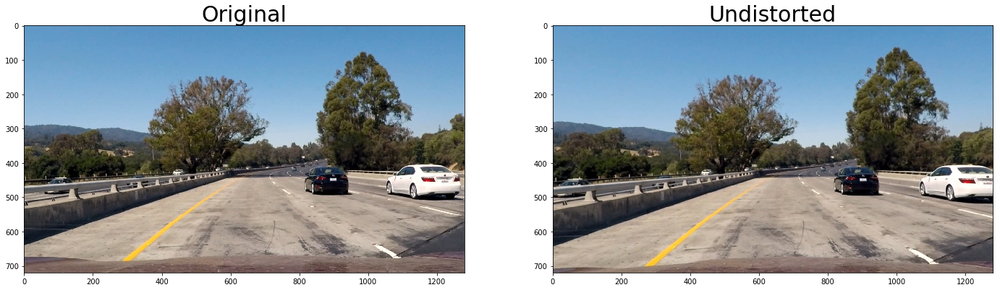

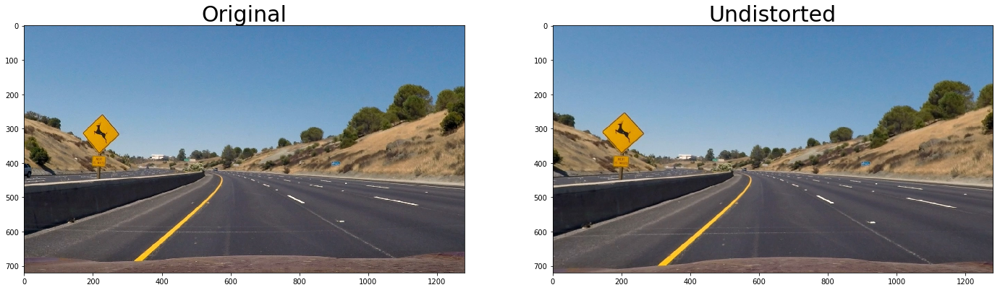

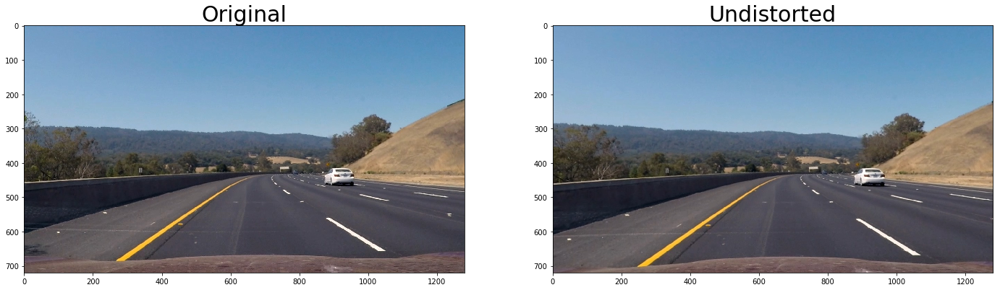

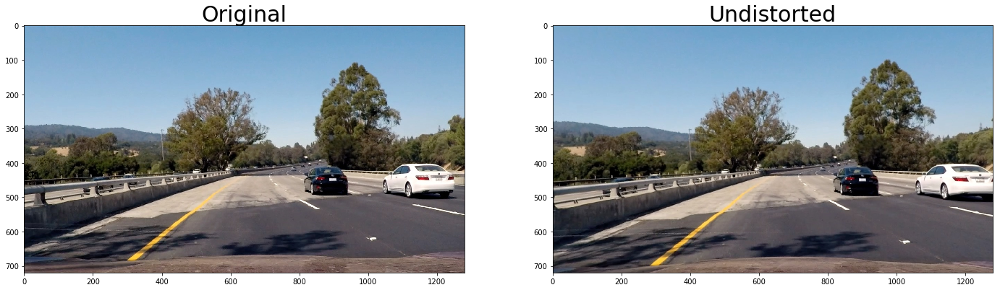

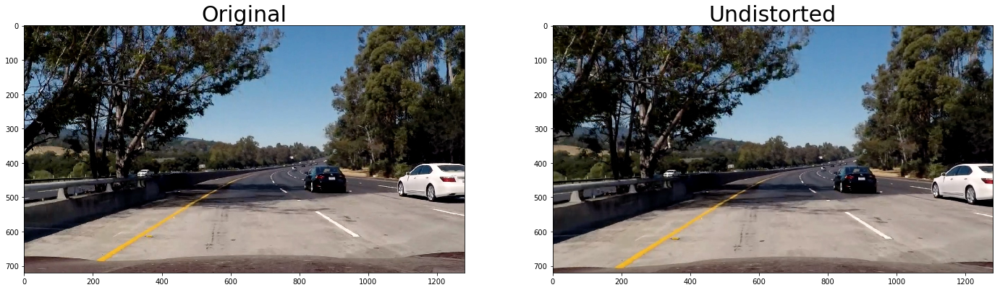

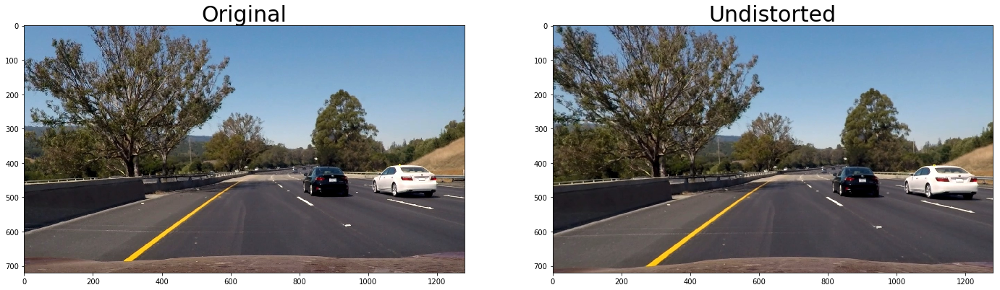

In [4]:
#%% Define function
def apply_distortion_correction(raw_image, mtx, dist):
    return cv2.undistort(raw_image, mtx, dist, None, mtx)

#%% Run task
undistorted_output_dir = get_image_output_dir('undistorted')

for test_image_path in test_image_paths:
    # Undistortion
    bgr = cv2.imread(str(test_image_path))
    rgb = cv2.cvtColor(bgr,cv2.COLOR_BGR2RGB)
    undistorted = apply_distortion_correction(rgb, mtx, dist)
    
    # Save
    result_map[test_image_path]['bgr'] = bgr
    result_map[test_image_path]['rgb'] = rgb
    result_map[test_image_path]['undistorted'] = undistorted
    
    # Plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 7))
    
    ax1.set_title('Original', fontsize=30)
    ax1.imshow(rgb)
    
    ax2.set_title('Undistorted', fontsize=30)
    ax2.imshow(undistorted)

    plt.savefig(str(undistorted_output_dir / (test_image_path.stem + '.jpg')))


### 3. Use color transforms, gradients, etc., to create a thresholded binary image.


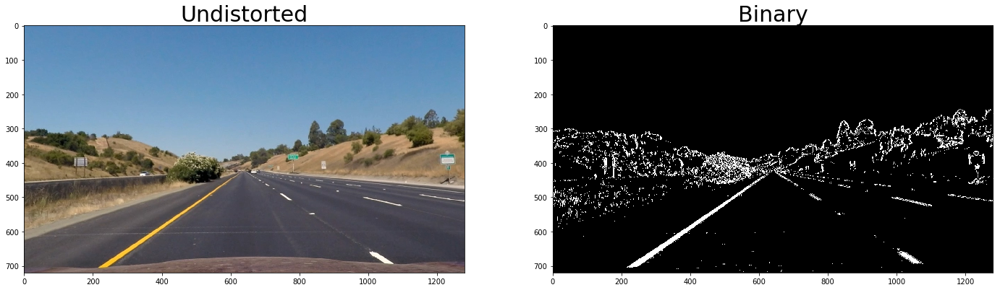

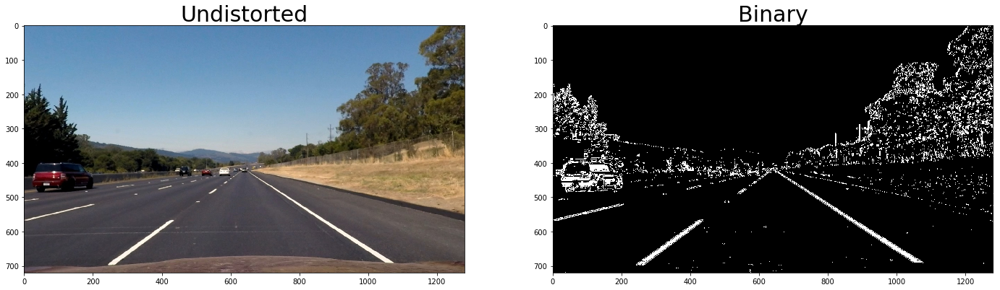

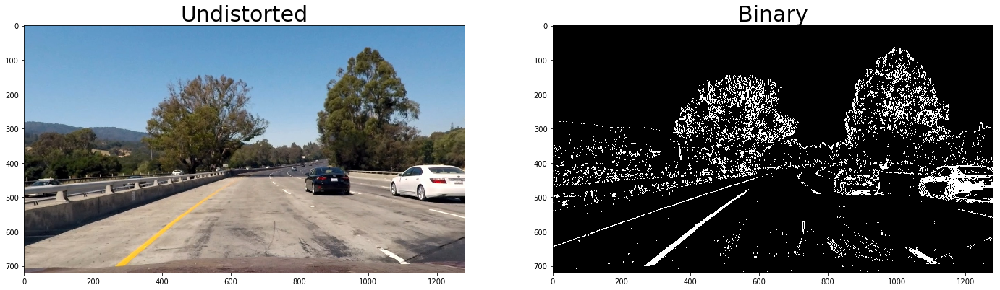

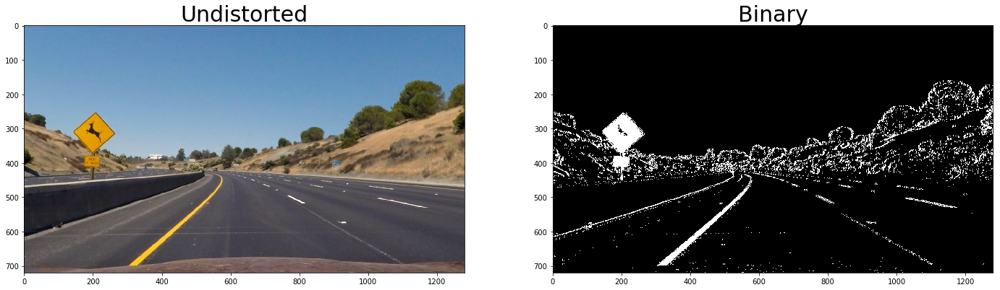

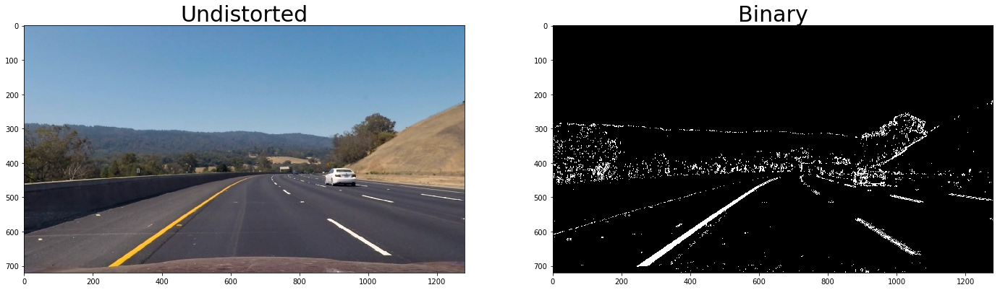

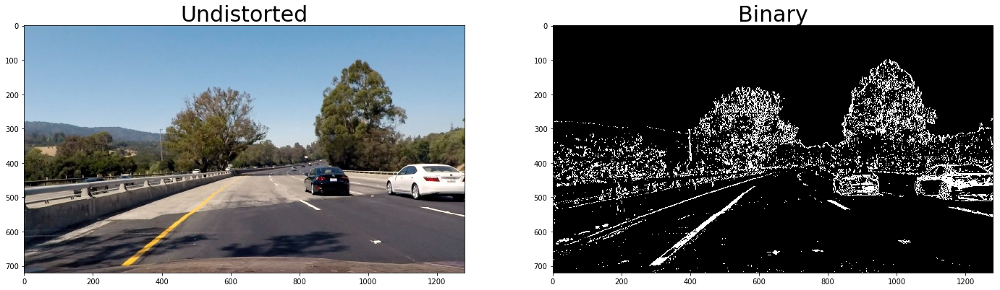

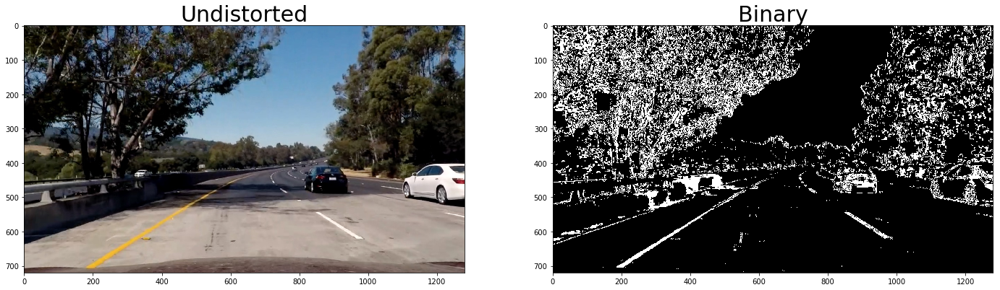

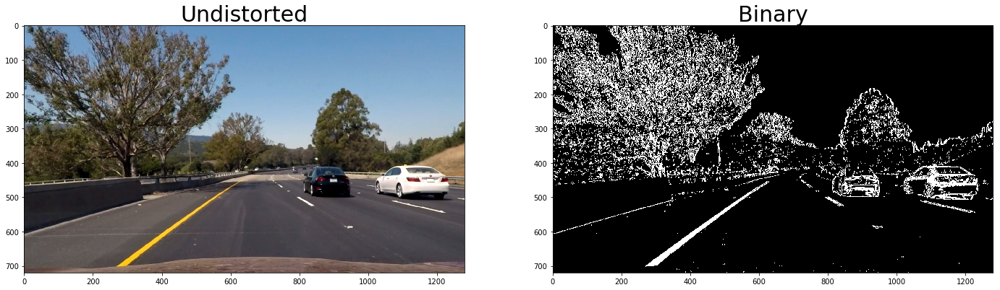

In [5]:
#%% Define function
def pipeline(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:, :, 1]
    s_channel = hls[:, :, 2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255 * abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

    # Stack each channel
    color_binary = np.dstack((np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    
    return combined_binary, color_binary

#%% Run task
binary_output_dir = get_image_output_dir('binary')

for test_image_path in test_image_paths:
    # To binary
    undistorted = result_map[test_image_path]['undistorted']    
    binary, color_binary = pipeline(undistorted)

    # Save
    result_map[test_image_path]['binary'] = binary
    
    # Plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 7))
    
    ax1.set_title('Undistorted', fontsize=30)
    ax1.imshow(undistorted)
    
    ax2.set_title('Binary', fontsize=30)
    ax2.imshow(binary, 'gray')

    plt.savefig(str(binary_output_dir / (test_image_path.stem + '.jpg')))
    

### 4. Apply a perspective transform to rectify binary image ("birds-eye view").


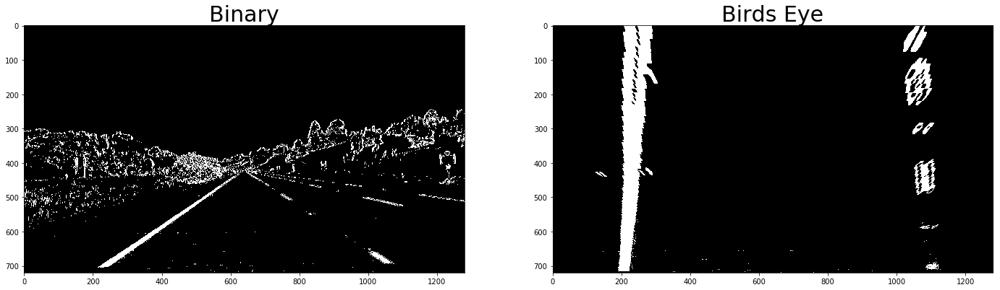

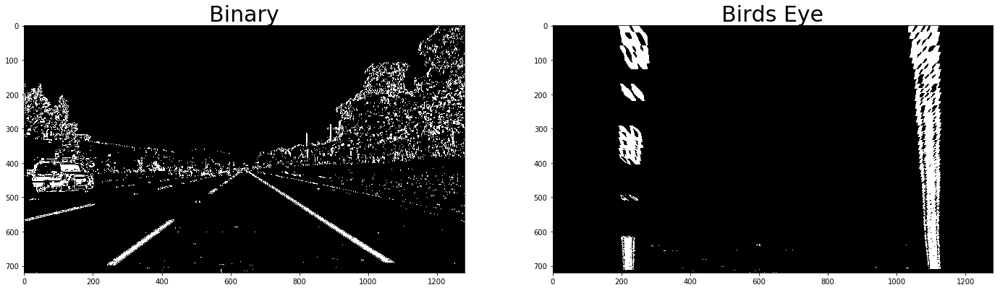

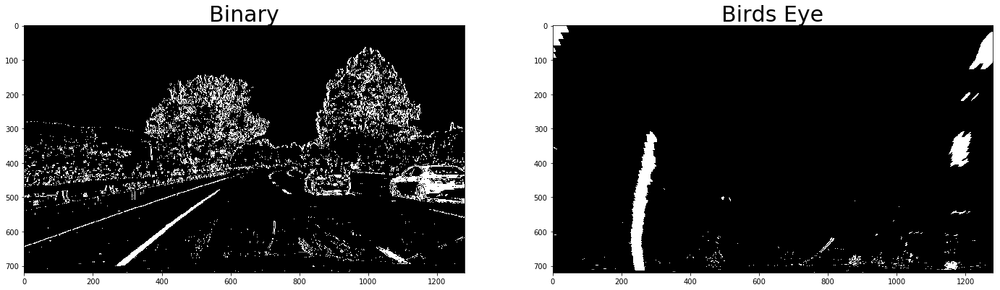

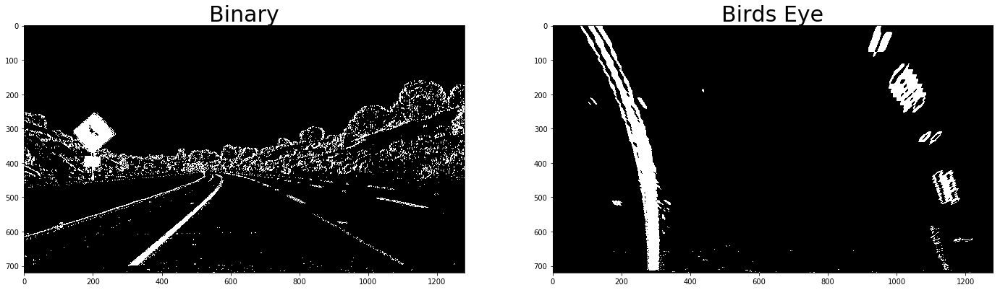

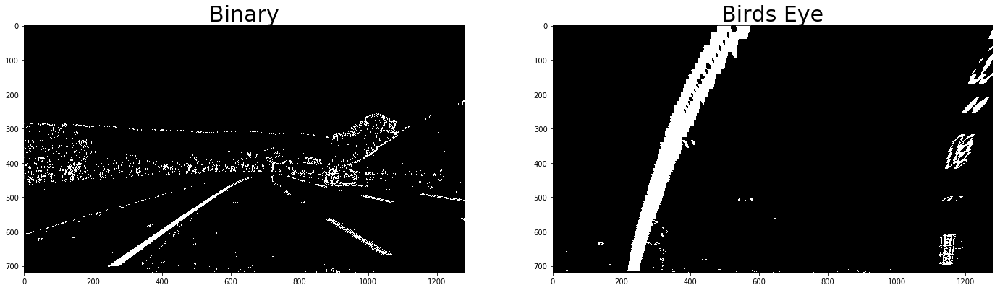

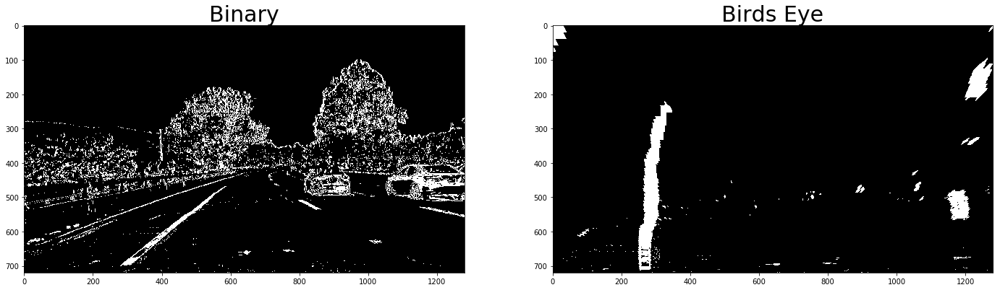

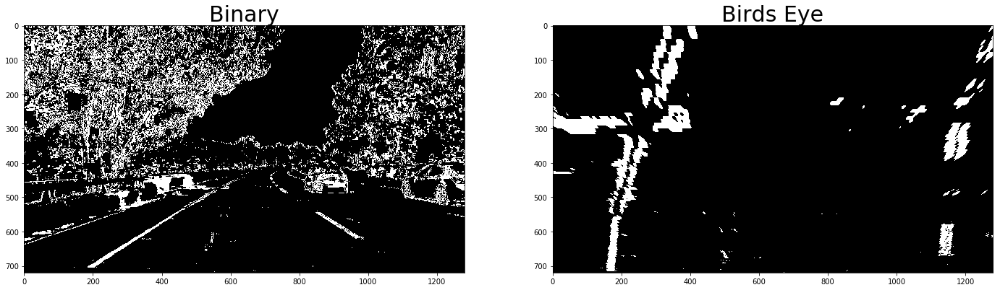

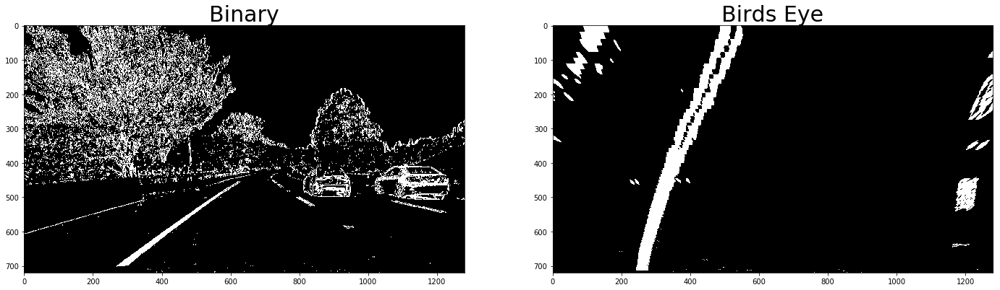

In [6]:
#%% Define function
def apply_perspective_transform(img):
    img_size = (img.shape[1], img.shape[0])
    height, width = img.shape[0], img.shape[1]
    
    # Move the points in the image
    src_tl = [0.45 * width, 0.63 * height]
    src_tr = [0.55 * width, 0.63 * height]
    src_br = [0.90 * width, 1.00 * height]
    src_bl = [0.10 * width, 1.00 * height]
    src = np.float32([src_tl, src_tr, src_br, src_bl])

    dst_tl = [0.10 * width, 0.00 * height]
    dst_tr = [0.90 * width, 0.00 * height]
    dst_br = [0.90 * width, 1.00 * height]
    dst_bl = [0.10 * width, 1.00 * height]    
    dst = np.float32([dst_tl, dst_tr, dst_br, dst_bl])
    
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size)
    
    return warped, M, Minv

#%% Run task
birds_eye_output_dir = get_image_output_dir('birds_eye')
        
for test_image_path in test_image_paths:
    # To birds eye
    binary = result_map[test_image_path]['binary']
    birds_eye, M, Minv = apply_perspective_transform(binary)
    
    # Save
    result_map[test_image_path]['birds_eye'] = birds_eye
    
    param_map[test_image_path]['M'] = M
    param_map[test_image_path]['Minv'] = Minv
    
    # Plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 7))
    
    ax1.set_title('Binary', fontsize=30)
    ax1.imshow(binary, 'gray')
    
    ax2.set_title('Birds Eye', fontsize=30)
    ax2.imshow(birds_eye, 'gray')

    plt.savefig(str(birds_eye_output_dir / (test_image_path.stem + '.jpg')))
        

### 5. Detect lane pixels and fit to find the lane boundary.


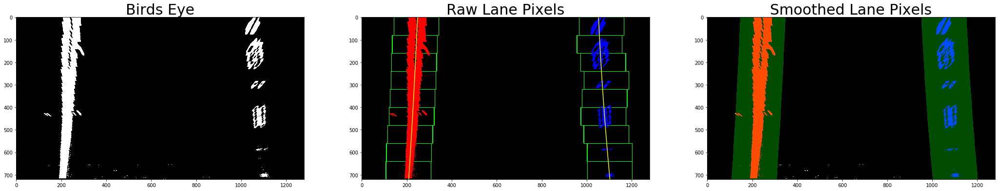

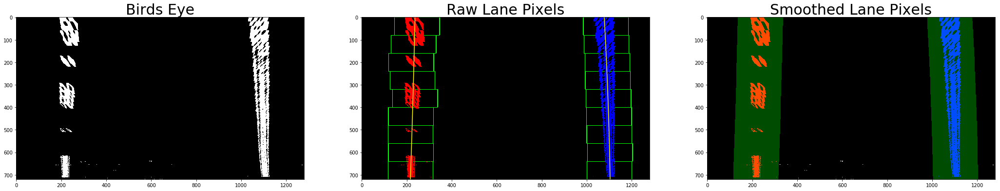

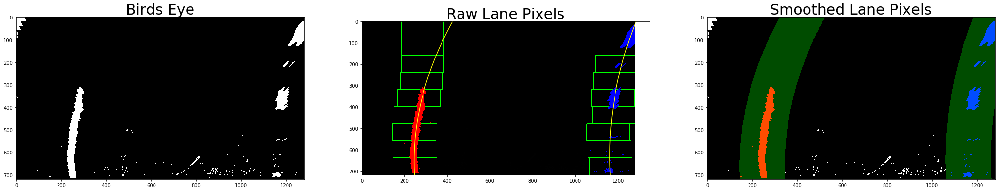

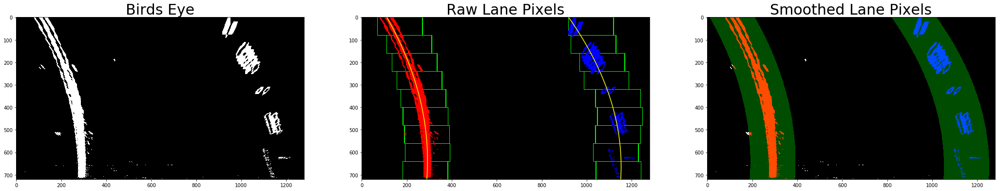

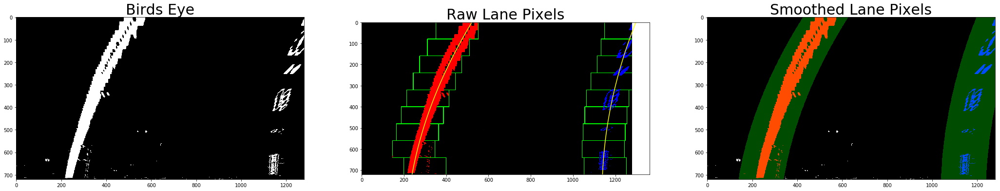

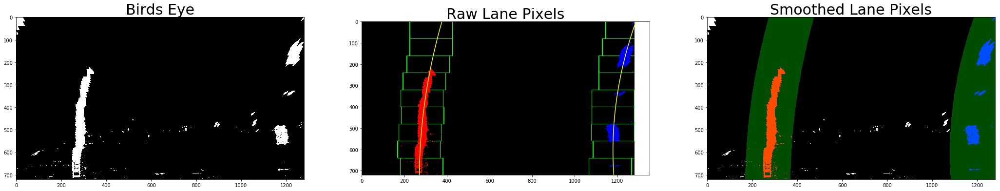

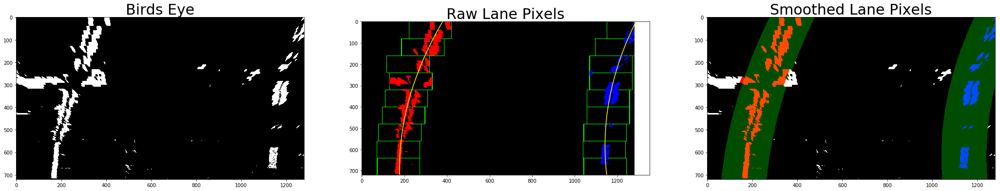

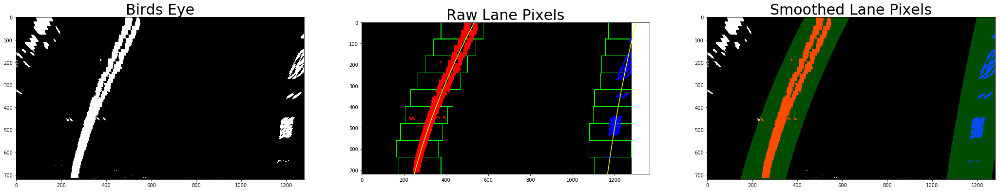

In [7]:
#%% Define function
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fit, right_fit, left_fitx, right_fitx, ploty

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    # Fit a second order polynomial to each with np.polyfit()
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    
    # Calc both polynomials using ploty, left_fit and right_fit #
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Set the area of search based on activated x-values
    # within the +/- margin of our polynomial function
    # Hint: consider the window areas for the similarly named variables
    # in the previous quiz, but change the windows to our new search area
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result

#%% Run task
lane_pixels_output_dir = get_image_output_dir('lane_pixels')
        
for test_image_path in test_image_paths:
    # Get lane pixels
    birds_eye = result_map[test_image_path]['birds_eye']
    raw_lane_pixels, left_fit, right_fit, left_fitx, right_fitx, ploty = fit_polynomial(birds_eye)
    smoothed_lane_pixels = search_around_poly(birds_eye, left_fit, right_fit)
    
    # Save
    result_map[test_image_path]['raw_lane_pixels'] = raw_lane_pixels
    result_map[test_image_path]['smoothed_lane_pixels'] = smoothed_lane_pixels
    
    param_map[test_image_path]['left_fitx'] = left_fitx
    param_map[test_image_path]['right_fitx'] = right_fitx
    param_map[test_image_path]['ploty'] = ploty
    
    # Plot
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(36, 7))
    
    ax1.set_title('Birds Eye', fontsize=30)
    ax1.imshow(birds_eye, 'gray')
    
    ax2.set_title('Raw Lane Pixels', fontsize=30)
    ax2.imshow(raw_lane_pixels, 'gray')
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')

    ax3.set_title('Smoothed Lane Pixels', fontsize=30)
    ax3.imshow(smoothed_lane_pixels, 'gray')
    
    plt.savefig(str(lane_pixels_output_dir / (test_image_path.stem + '.jpg')))
        

### 6. Determine the curvature of the lane and vehicle position with respect to center.


In [8]:
#%% Define function
def estimate_curvature(leftx, rightx, ploty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Fit a second order polynomial to pixel positions in each fake lane line
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
        
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return (left_curverad + right_curverad) / 2

def estimate_vehicle_offset(px_center, px_left_lane, px_right_lane):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    px_offset = (px_left_lane + px_right_lane) / 2 - px_center
    return xm_per_pix * px_offset

### 7. Warp the detected lane boundaries back onto the original image.
### 8. Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

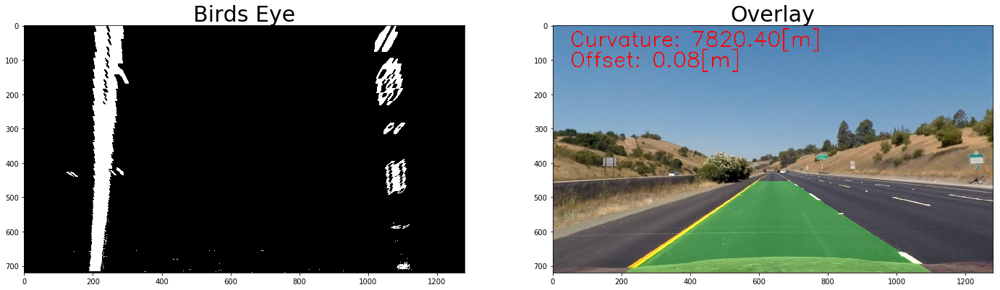

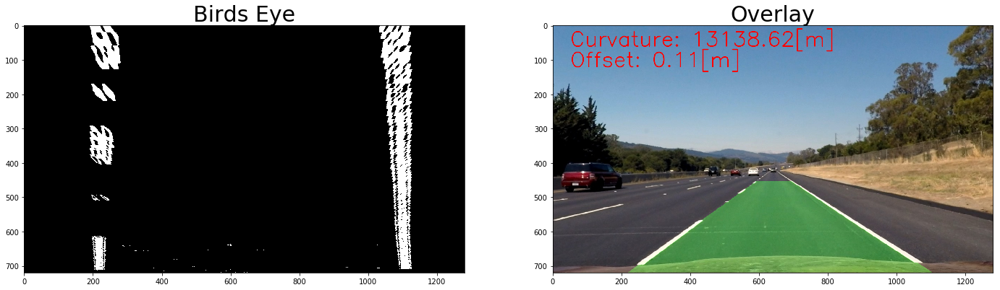

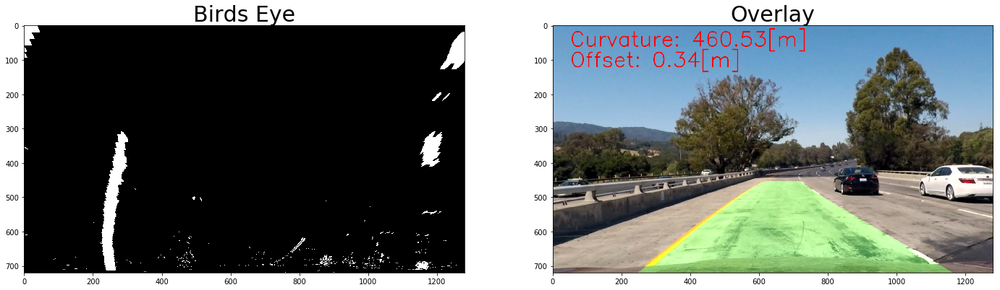

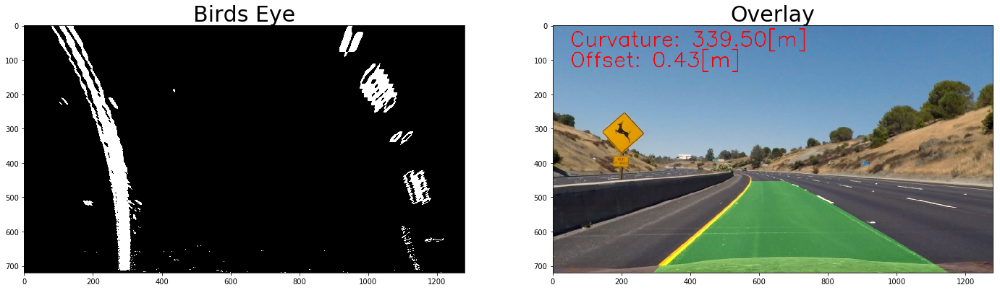

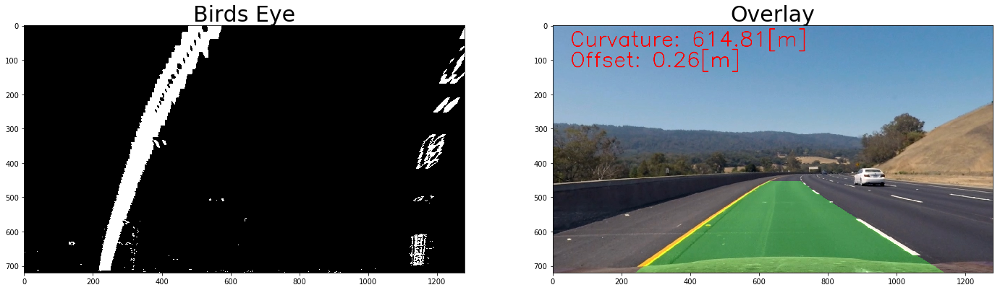

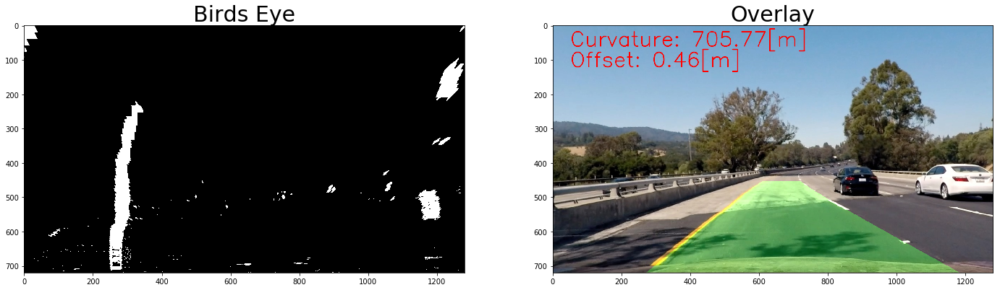

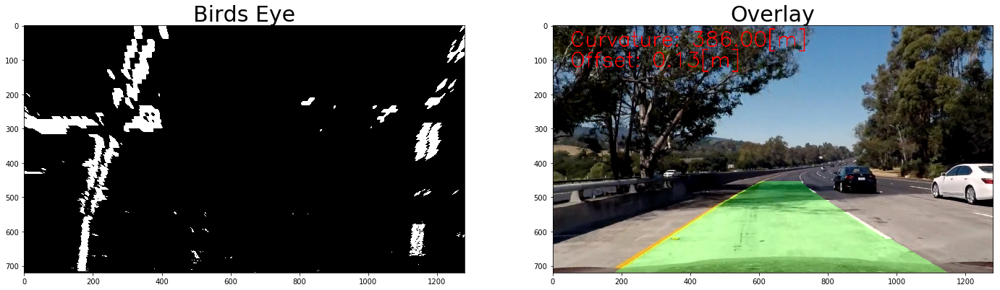

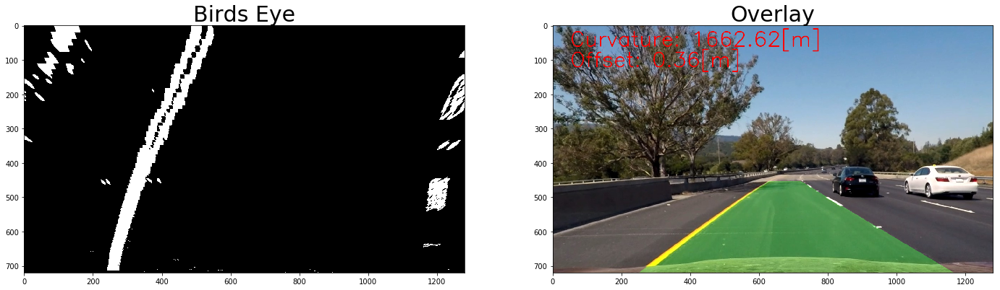

In [9]:
#%% Define function
def warp_back_lane_boundaries(undistorted, birds_eye, left_fitx, right_fitx, ploty):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(birds_eye).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undistorted.shape[1], undistorted.shape[0])) 
    
    # Combine the result with the original image
    result = cv2.addWeighted(undistorted, 1, newwarp, 0.3, 0)
    
    return result

#%% Run task
overlay_output_dir = get_image_output_dir('overlay')
        
for test_image_path in test_image_paths:
    # Overlay lane pixels
    undistorted = result_map[test_image_path]['undistorted']
    birds_eye = result_map[test_image_path]['birds_eye']
    
    left_fitx = param_map[test_image_path]['left_fitx']
    right_fitx = param_map[test_image_path]['right_fitx']
    ploty = param_map[test_image_path]['ploty']
    
    overlay = warp_back_lane_boundaries(undistorted, birds_eye, left_fitx, right_fitx, ploty)
    
    # Overlay text
    curvature = estimate_curvature(left_fitx, right_fitx, ploty)
    vehicle_offset = estimate_vehicle_offset(undistorted.shape[1] / 2, left_fitx[-1], right_fitx[-1])
    text_curve = f'Curvature: {curvature:.2f}[m]'
    text_offset = f'Offset: {vehicle_offset:.2f}[m]'

    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(overlay, text_curve, (50, 60), font, 2, (255,0,0), 2, cv2.LINE_AA)
    cv2.putText(overlay, text_offset, (50, 120), font, 2, (255,0,0), 2, cv2.LINE_AA)
    
    # Plot
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 7))
    
    ax1.set_title('Birds Eye', fontsize=30)
    ax1.imshow(birds_eye, 'gray')
    
    ax2.set_title('Overlay', fontsize=30)
#     ax2.text(50, 40, text_curve + "\n" + text_offset, color="red", fontdict={"fontsize": 20, "ha": "left", "va": "top"})
    ax2.imshow(overlay)
    
    plt.savefig(str(overlay_output_dir / (test_image_path.stem + '.jpg')))
    

## Test On Videos

In [10]:
def process_image(image):
    # Undistortion
    rgb = image
    undistorted = apply_distortion_correction(rgb, mtx, dist)
    
    # To binary
    binary, color_binary = pipeline(undistorted)
    
    # To birds eye
    birds_eye, M, Minv = apply_perspective_transform(binary)
    
    # Get lane pixels
    raw_lane_pixels, left_fit, right_fit, left_fitx, right_fitx, ploty = fit_polynomial(birds_eye)
    smoothed_lane_pixels = search_around_poly(birds_eye, left_fit, right_fit)
    
    # Overlay lane pixels
    overlay = warp_back_lane_boundaries(undistorted, birds_eye, left_fitx, right_fitx, ploty)
    
    # Overlay text
    curvature = estimate_curvature(left_fitx, right_fitx, ploty)
    vehicle_offset = estimate_vehicle_offset(undistorted.shape[1] / 2, left_fitx[-1], right_fitx[-1])
    text_curve = f'Curvature: {curvature:.2f}[m]'
    text_offset = f'Offset: {vehicle_offset:.2f}[m]'

    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(overlay, text_curve, (50, 60), font, 2, (255,0,0), 2, cv2.LINE_AA)
    cv2.putText(overlay, text_offset, (50, 120), font, 2, (255,0,0), 2, cv2.LINE_AA)
    
    return overlay

def process_video(video_path):
    output_dir = Path('test_videos_output')
    output_dir.mkdir(exist_ok=True)
    clip1 = VideoFileClip(video_path.name)
    output_video = str(output_dir / video_path.name)
    clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
    %time clip.write_videofile(output_video, audio=False)


In [11]:
process_video(Path('./project_video.mp4'))

Moviepy - Building video test_videos_output\project_video.mp4.
Moviepy - Writing video test_videos_output\project_video.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output\project_video.mp4
Wall time: 12min 7s


In [12]:
process_video(Path('./challenge_video.mp4'))

Moviepy - Building video test_videos_output\challenge_video.mp4.
Moviepy - Writing video test_videos_output\challenge_video.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output\challenge_video.mp4
Wall time: 4min 47s


In [13]:
process_video(Path('./harder_challenge_video.mp4'))

Moviepy - Building video test_videos_output\harder_challenge_video.mp4.
Moviepy - Writing video test_videos_output\harder_challenge_video.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output\harder_challenge_video.mp4
Wall time: 12min 35s
